# <center>Thesis Related Jupyter Notebook</center>

<ins>Some Notes</ins>:
* Always plot $O$- and $E$-beams in that order to avoid confusion.
* Always include `data_path` and `save_path` to avoid overwriting data, etc.
* Avoid overwriting `plt.rcParams` to keep consistent styling throughout thesis.
* `!` may be used for inline CLI commands, e.g. `!ls`.
    * `{}` or `$` may be used for inline variables, e.g. `!ls $save_path`.

In [82]:
# Import modules
import os
from pathlib import Path
from typing import Literal

import astropy.io.fits as pyfits
import numpy as np
from matplotlib.colors import Colormap
import matplotlib.pyplot as plt

# Matplotlib style
plt.style.use('/media/justin/Transcend/STOPS/utils/STOPS.mplstyle')
# from astropy.visualization import astropy_mpl_style
# plt.style.use(astropy_mpl_style)

# Custom functions
def imshow(
    image: np.ndarray,
    vmin: float=None,
    vmax: float=None,
    cmap: str | Colormap=None,
    cbar: dict=None,
    save_name: str | os.PathLike=None,
    height: Literal['auto'] | int='auto',
):
    # Calculate figure size
    aspect = image.shape[1] / image.shape[0]
    if height == 'auto':
        height = plt.rcParams["figure.figsize"][0] / aspect
    elif height:
        height = height
    else:
        height = plt.rcParams["figure.figsize"][1]

    height += (height / 5) * (cbar is not None)
    plot_params = {
        'figure.figsize': [plt.rcParams["figure.figsize"][0], height],
        'figure.subplot.left': 0,
        'figure.subplot.bottom': 0,
        'figure.subplot.right': 1,
        'figure.subplot.top': 1,
        'figure.subplot.wspace': 0,
        'figure.subplot.hspace': 0,
    }

    with plt.rc_context(plot_params):
        fig, ax = plt.subplots()

        # Display image
        im = ax.imshow(image, origin='lower', vmin=vmin, vmax=vmax, cmap=cmap)
        ax.axis('off')

        # Add colorbar if requested
        if cbar:
            fig.colorbar(im, ax=ax, **cbar)

        # Save image
        if save_name:
            fig.savefig(save_name)

        # Ensure show image
        plt.show()

/tmp/ipykernel_5702/3175227163.py:12: UserWarning: Style includes a parameter, 'figure.raise_window', that is not related to style.  Ignoring this parameter.
  plt.style.use('/media/justin/Transcend/STOPS/utils/STOPS.mplstyle')
/tmp/ipykernel_5702/3175227163.py:12: UserWarning: Style includes a parameter, 'savefig.directory', that is not related to style.  Ignoring this parameter.
  plt.style.use('/media/justin/Transcend/STOPS/utils/STOPS.mplstyle')


## Introduction <span style='float:right'>Chapter 01</span>

## Spectropolarimetry and the <span style="font-variant:small-caps;">salt</span> RSS <span style='float:right'>Chapter 02</span>

## Existing and Developed Software <span style='float:right'>Chapter 03</span>

### $\S~3.2.4$ - Transform

Filename: chapter_3/figures/3_tarcO.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     215   (3199, 474)   float32   
Filename: chapter_3/figures/3_tarcE.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     215   (3199, 474)   float32   


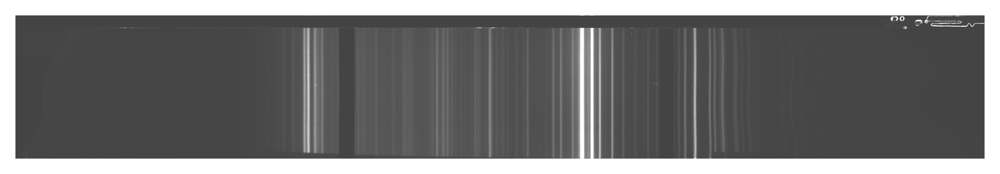

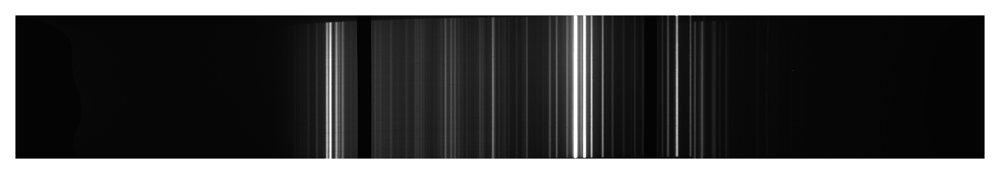

In [83]:
data_path = Path('./chapter_3/figures')
save_path = Path('./chapter_3/figures')

with pyfits.open(data_path / '3_tarcO.fits') as hdul_tO, \
     pyfits.open(data_path / '3_tarcE.fits') as hdul_tE:

    hdul_tO.info()
    hdul_tE.info()

    imshow(
        hdul_tO['Primary'].data,
        # vmin=-2 * image_fileO['Primary'].data.std(),
        vmax= 2 * hdul_tO['Primary'].data.std(),
        save_name=save_path / '3_tarcO.pdf',
    )
    imshow(
        hdul_tE['Primary'].data,
        # vmin=-2 * image_fileE['Primary'].data.std(),
        vmax= 2 * hdul_tE['Primary'].data.std(),
        save_name=save_path / '3_tarcE.pdf',
    )

### $\S~3.3.1$ - Splitting

Filename: ../Masters_20-24/Data/3C_279/20170517_Ne/sci/obeam0069.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     162   (3199, 474)   float32   
Filename: ../Masters_20-24/Data/3C_279/20170517_Ne/sci/ebeam0069.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     162   (3199, 474)   float32   


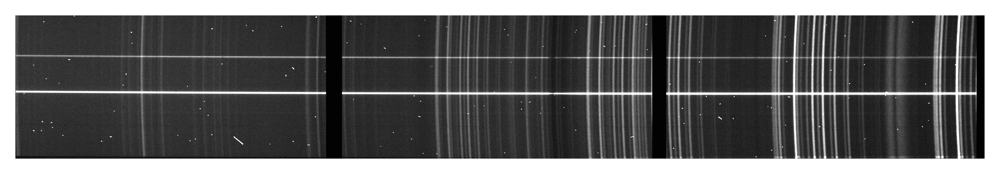

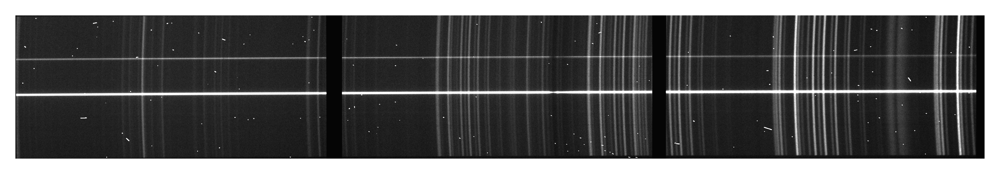

In [84]:
data_path = Path('../Masters_20-24/Data/3C_279/20170517_Ne/sci')
save_path = Path('./chapter_3/figures')

with pyfits.open(data_path / 'obeam0069.fits') as hdul_sO, \
     pyfits.open(data_path / 'ebeam0069.fits') as hdul_sE:

    hdul_sO.info()
    hdul_sE.info()

    imshow(
        hdul_sO['Primary'].data,
        # vmin=-2 * image_fileO['Primary'].data.std(),
        vmax= 2 * hdul_sO['Primary'].data.std(),
        save_name=save_path / '3_splitO.pdf',
    )
    imshow(
        hdul_sE['Primary'].data,
        # vmin=-2 * image_fileE['Primary'].data.std(),
        vmax= 2 * hdul_sE['Primary'].data.std(),
        save_name=save_path / '3_splitE.pdf',
    )

### $\S~3.3.2$ - Joining

Filename: ../Masters_20-24/Data/3C_279/20170517_Ne/sci/wmxgbpP201705170069.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     161   ()      
  1  SCI           1 ImageHDU        21   (3199, 474, 2)   float32   
  2  VAR           1 ImageHDU        10   (3199, 474, 2)   float32   
  3  BPM           1 ImageHDU        10   (3199, 474, 2)   uint8   
  4  WAV           1 ImageHDU        21   (3199, 474, 2)   float32   


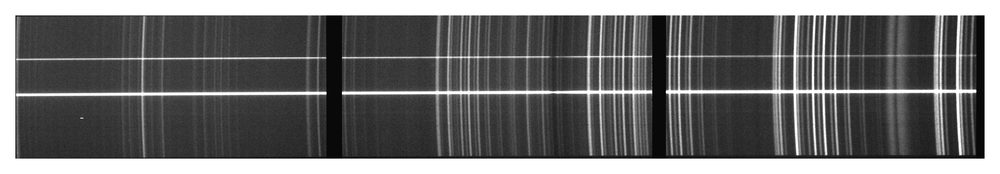

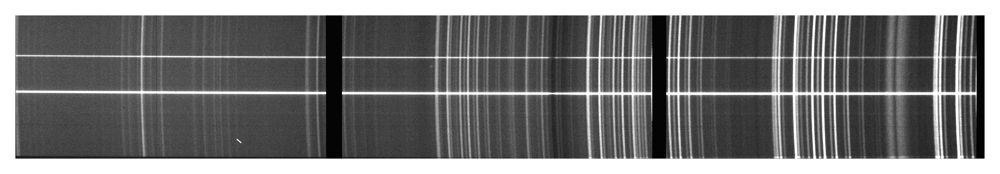

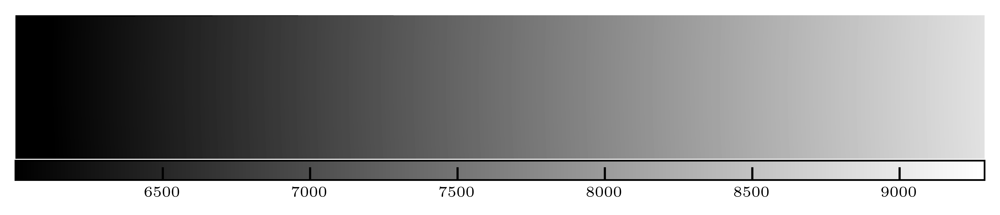

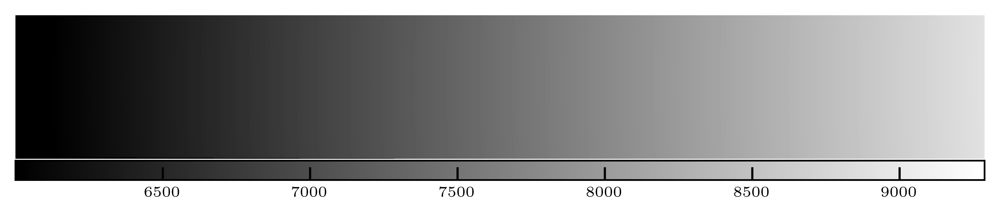

In [88]:
data_path = Path('../Masters_20-24/Data/3C_279/20170517_Ne/sci')
save_path = Path('./chapter_3/figures')

with pyfits.open(data_path / 'wmxgbpP201705170069.fits') as hdul:

    hdul.info()

    imshow(
        hdul['SCI'].data[0],
        # vmin=-2 * np.std(image_fileO['Primary'].data),
        vmax= 2 * np.std(hdul['SCI'].data),
        save_name=save_path / '3_post_wav_cal_O.pdf',
    )
    imshow(
        hdul['SCI'].data[1],
        # vmin=-2 * np.std(image_fileO['Primary'].data),
        vmax= 2 * np.std(hdul['SCI'].data),
        save_name=save_path / '3_post_wav_cal_E.pdf',
    )

    imshow(
        hdul['WAV'].data[0],
        vmin=hdul['WAV'].data.mean() - 1.5 * hdul['WAV'].data.std(),
        vmax=hdul['WAV'].data.mean() + 2 * hdul['WAV'].data.std(),
        cbar={'orientation':'horizontal', 'aspect':50, 'pad':0.01},
        save_name=save_path / '3_pol_wav_O.pdf',
    )
    imshow(
        hdul['WAV'].data[1],
        vmin=hdul['WAV'].data.mean() - 1.5 * hdul['WAV'].data.std(),
        vmax=hdul['WAV'].data.mean() + 2 * hdul['WAV'].data.std(),
        cbar={'orientation':'horizontal', 'aspect':50, 'pad':0.01},
        save_name=save_path / '3_pol_wav_E.pdf',
    )

### $\S~3.4.2$ - <span style="font-variant:small-caps">polsalt</span> Pre-reductions

Filename: ../Masters_20-24/Data/3C_279/20170517_Ne/sci/mxgbpP201705170069.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     161   ()      
  1  SCI           1 ImageHDU        19   (3199, 1028)   float32   
  2  VAR           1 ImageHDU         8   (3199, 1028)   float32   
  3  BPM           1 ImageHDU         8   (3199, 1028)   uint8   


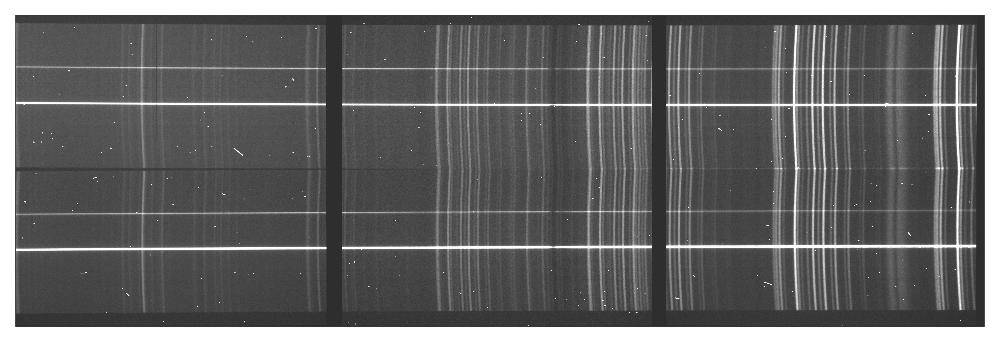

In [86]:
data_path = Path('../Masters_20-24/Data/3C_279/20170517_Ne/sci')
save_path = Path('./chapter_3/figures')

with pyfits.open(data_path / 'mxgbpP201705170069.fits') as hdul:

    hdul.info()

    imshow(
        hdul['SCI'].data,
        # vmin=-2 * np.std(image_fileO['SCI'].data),
        vmax= 2 * hdul['SCI'].data.std(),
        save_name=save_path / '3_pre_wav_cal.pdf',
    )

## Testing and Application <span style='float:right'>Chapter 04</span>

### $\S~4.1.1$ - Testing the `split` Method

#### Header Differences

In [48]:
data_path = Path('../STOPS/test_data/20170328/sci')

!fitsdiff --exact {data_path / 'mxgbpP201703280054.fits'} {data_path / 'beamo0054.fits'}
!fitsdiff --exact {data_path / 'mxgbpP201703280054.fits'} {data_path / 'beame0054.fits'}
!fitsdiff --exact {data_path / 'beamo0054.fits'} {data_path / 'beame0054.fits'}


 fitsdiff: 6.0.0
 a: ../STOPS/test_data/20170328/sci/mxgbpP201703280054.fits
 b: ../STOPS/test_data/20170328/sci/beamo0054.fits
 Maximum number of different data values to be reported: 10
 Relative tolerance: 0.0, Absolute tolerance: 0.0

Files contain different numbers of HDUs:
 a: 4
 b: 1

Primary HDU:

   Headers contain differences:
     Headers have different number of cards:
      a: 161
      b: 162
     Extra keyword 'EXTEND' in a: True
     Extra keyword 'NAXIS1' in b: 3199
     Extra keyword 'NAXIS2' in b: 474
     Keyword BITPIX   has different values:
        a> 8
        b> -32
     Keyword BITPIX   has different comments:
        a> number of bits per data pixel
        b> array data type
     Keyword NAXIS    has different values:
        a> 0
        b> 2
     Keyword NAXIS    has different comments:
        a> number of data axes
        b> number of array dimensions
     Keyword SIMPLE   has different comments:
        a> file does conform to FITS standard
         ?

#### Data Differences

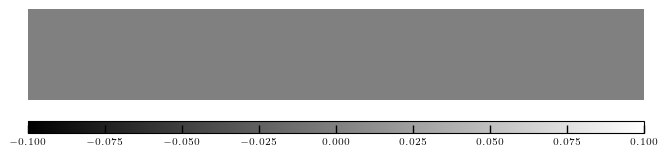

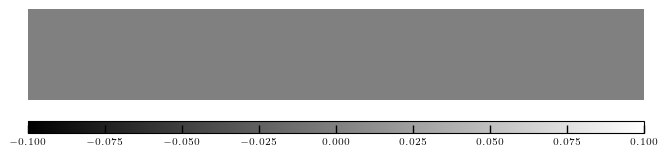

In [46]:
data_path = Path('../STOPS/test_data/20170328/sci')
save_path = Path('./chapter_4/figures')

with pyfits.open(data_path / 'mxgbpP201703280054.fits') as hdul_pol, \
     pyfits.open(data_path / 'beamo0054.fits') as hdul_o, \
     pyfits.open(data_path / 'beame0054.fits') as hdul_e:
    
    pol_shape = hdul_pol['SCI'].shape
    offset = 517 - pol_shape[0]//2

    pol_o_diff = hdul_pol['SCI'].data[pol_shape[0]//2 + offset:-40 + offset] - hdul_o['Primary'].data
    pol_e_diff = hdul_pol['SCI'].data[40 + offset:pol_shape[0]//2 + offset] - hdul_e['Primary'].data

    imshow(
        pol_o_diff,
        # vmin=-0.5 * pol_o_diff.std(),
        vmax=0.5 * pol_o_diff.std(),
        cbar={'orientation':'horizontal', 'aspect':50},
        # save_name=save_path / '4_pol_diff_O.pdf',
    )
    imshow(
        pol_e_diff,
        # vmin=-0.5 * pol_e_diff.std(),
        vmax=0.5 * pol_e_diff.std(),
        cbar={'orientation':'horizontal', 'aspect':50},
        # save_name=save_path / '4_pol_diff_E.pdf',
    )

### $\S~4.1.2$ - Testing the `join` Method

#### Header Differences

In [14]:
data_path = Path('../STOPS/test_data/20170328/sci')

# !fitsinfo {data_path / '../polsalt_sci' / 'wmxgbpP201703280054.fits'}
# !fitsinfo {data_path / 'wmxgbpP201703280054.fits'}
!fitsdiff --exact {data_path / '../polsalt_sci' / 'wmxgbpP201703280054.fits'} {data_path / 'wmxgbpP201703280054.fits'}


 fitsdiff: 2.0.16
 a: ../STOPS/test_data/20170328/sci/../polsalt_sci/wmxgbpP201703280054.fits
 b: ../STOPS/test_data/20170328/sci/wmxgbpP201703280054.fits
 Maximum number of different data values to be reported: 10
 Relative tolerance: 0.0, Absolute tolerance: 0.0

Primary HDU:

   Headers contain differences:
     Keyword HISTORY  has different values:
        a> CRCLEAN: upper= 4.0, lower= 1.5, sigmaveto= 2.0
        b> CRCLEAN: None
     Keyword SAL-TLM  has different values:
        a> Tue Jul 23 17:46:38 2024
        b> Thu Mar 24 10:36:36 2022
     Keyword SMOSAIC  has different values:
        a> Tue Jul 23 17:46:38 2024
        b> Thu Mar 24 10:36:36 2022

Extension HDU 1:

   Headers contain differences:
     Keyword NAXIS2   has different values:
        a> 514
        b> 474

   Data contains differences:
     Data dimensions differ:
      a: 3199 x 514 x 2
      b: 3199 x 474 x 2
     No further data comparison performed.

Extension HDU 2:

   Headers contain differences:


#### Data Differences

##### <center><span style="font-variant:small-caps;">polsalt</span> `wmxgbp*.fits` == <span style="font-variant:small-caps;">polsalt</span> `mxgbp*.fits`? </center>

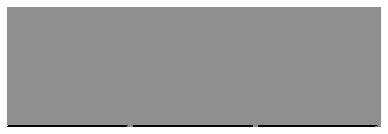

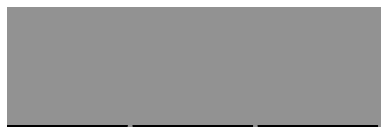

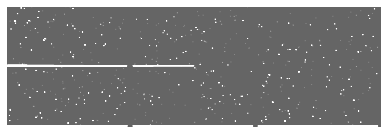

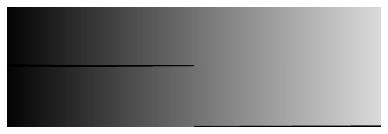

In [27]:
data_path = Path('../STOPS/test_data/20170328/sci')
save_path = Path('./chapter_4/figures')

roll_val = 6

with pyfits.open(data_path / '../polsalt_sci' / 'wmxgbpP201703280054.fits') as hdul_wpol, \
     pyfits.open(data_path / 'mxgbpP201703280054.fits') as hdul_mpol:

    for ext in ['SCI', 'VAR', 'BPM']:

        wav_diff = np.roll(np.concatenate(hdul_wpol[ext].data, axis=0), roll_val, axis=0) - hdul_mpol[ext].data

        imshow(
            wav_diff,
            vmin=wav_diff.mean() - 0.5 * wav_diff.std(),
            vmax=wav_diff.mean() + 0.5 * wav_diff.std(),
            # save_name=save_path / f'4_wav_diff_{ext}.pdf',
        )

    ext = 'WAV'
    imshow(
        np.roll(np.concatenate(hdul_wpol[ext].data, axis=0), roll_val, axis=0),
        vmin=hdul_wpol['WAV'].data.mean() - 1.5 * hdul_wpol['WAV'].data.std(),
        vmax=hdul_wpol['WAV'].data.mean() + 2 * hdul_wpol['WAV'].data.std(),
        # save_name=save_path / f'4_wav_diff_{ext}.pdf',
    )

##### <center><span style="font-variant:small-caps;">stops</span> `wmxgbp*.fits` == <span style="font-variant:small-caps;">polsalt</span> `mxgbp*.fits`? </center>

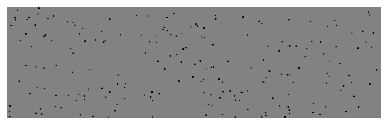

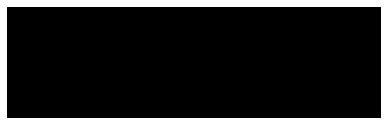

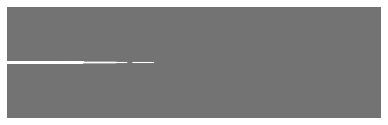

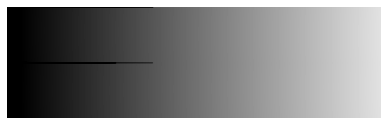

In [40]:
data_path = Path('../STOPS/test_data/20170328/sci')
save_path = Path('./chapter_4/figures')

roll_val = -3

with pyfits.open(data_path / 'wmxgbpP201703280054.fits') as hdul_wstops, \
     pyfits.open(data_path / 'mxgbpP201703280054.fits') as hdul_mpol:

    for ext in ['SCI', 'VAR', 'BPM']:

        wav_diff = np.concatenate(hdul_wstops[ext].data, axis=0) - np.roll(hdul_mpol[ext].data, roll_val, axis=0)[40:-40]
        # wav_diff = np.roll(np.concatenate(hdul_wstops[ext].data, axis=0), roll_val, axis=0) - hdul_mpol[ext].data[40:-40]

        imshow(
            wav_diff,
            vmin=wav_diff.mean() - 0.5 * wav_diff.std(),
            vmax=wav_diff.mean() + 0.5 * wav_diff.std(),
            # save_name=save_path / f'4_wav_diff_{ext}.pdf',
        )

    ext = 'WAV'
    imshow(
        np.concatenate(np.roll(hdul_wstops[ext].data, roll_val, axis=1), axis=0),
        vmin=hdul_wstops['WAV'].data.mean() - 1.5 * hdul_wstops['WAV'].data.std(),
        vmax=hdul_wstops['WAV'].data.mean() + 2 * hdul_wstops['WAV'].data.std(),
        # save_name=save_path / f'4_wav_diff_{ext}.pdf',
    )

##### <center><span style="font-variant:small-caps;">iraf</span> `wmxgbp*.fits` == <span style="font-variant:small-caps;">polsalt</span> `wmxgbp*.fits`? </center>

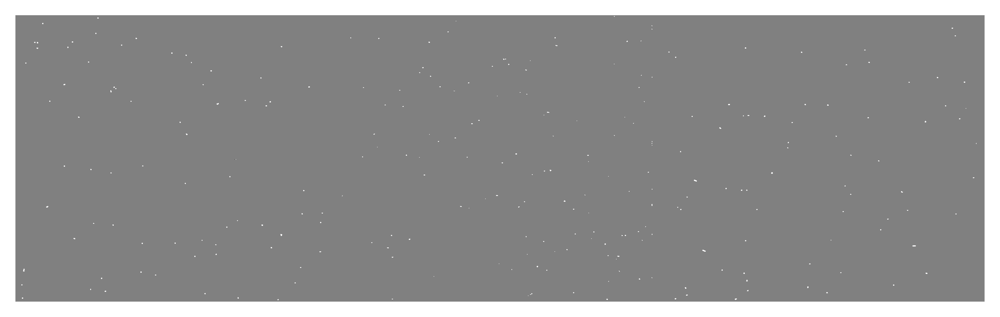

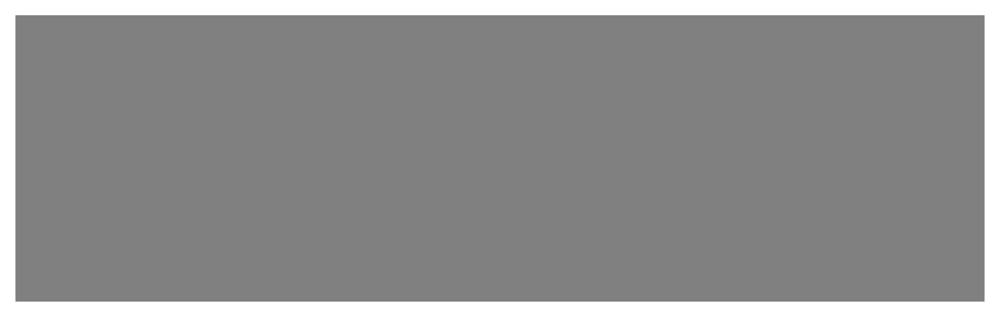

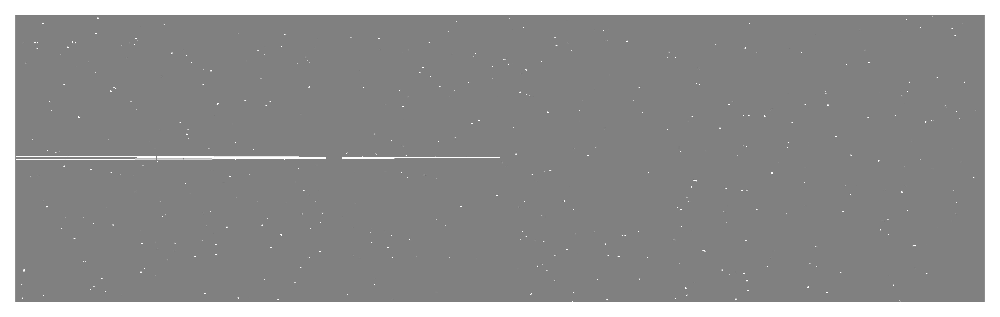

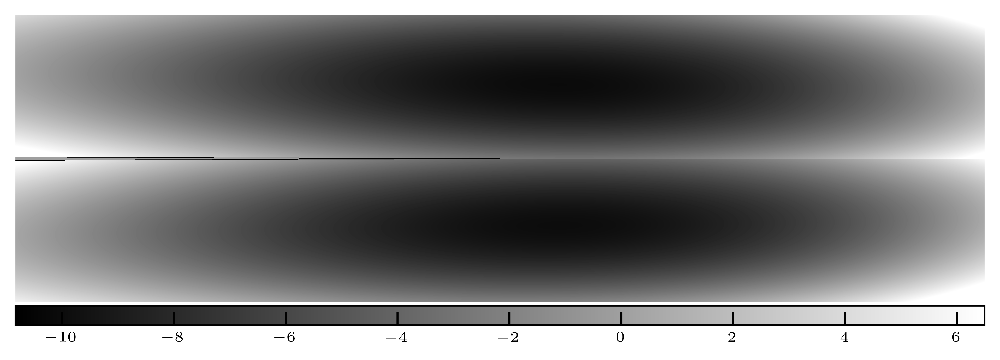

In [90]:
data_path = Path('../STOPS/test_data/20170328/sci')
save_path = Path('./chapter_4/figures')

roll_val = 3

with pyfits.open(data_path / '../polsalt_sci' / 'wmxgbpP201703280054.fits') as hdul_pol, \
     pyfits.open(data_path / 'wmxgbpP201703280054.fits') as hdul_iraf:

    for ext in ['SCI', 'VAR', 'BPM', 'WAV']:

        diff_ext = np.concatenate(hdul_pol[ext].data, axis=0) if ext=='WAV' else np.roll(np.concatenate(hdul_pol[ext].data, axis=0), roll_val, axis=0)
        iraf_ext = np.zeros_like(diff_ext)
        iraf_ext[40:iraf_ext.shape[0]//2] = hdul_iraf[ext].data[0]
        iraf_ext[-iraf_ext.shape[0]//2:-40] = hdul_iraf[ext].data[1]
        diff_ext -= iraf_ext
        diff_ext = diff_ext[40:-40]

        vmin = -1 if ext=='VAR' else -0.01 * diff_ext.std() * (1 + 4 * (ext=='WAV'))
        vmax =  1 if ext=='VAR' else  0.01 * diff_ext.std() * (1 + 2 * (ext=='WAV'))
        
        imshow(
            diff_ext,
            vmin=vmin,
            vmax=vmax,
            cbar={'orientation':'horizontal', 'aspect':50, 'pad':0.01} if ext=='WAV' else None,
            save_name=save_path / f'4_diff_{ext}.pdf',
        )

### $\S~4.2.1$ - Cross Correlation Checks

### $\S~4.2.2$ - Sky Line Checks